# Explorative Data Analysis
Exploring AirBnB listings in Paris
Source: https://www.kaggle.com/vaibhav2025/airbnb-listings-reviews
Dataset file is original one preprocessed by PrepData notebook


#### Importing libraries, we'll start with numerical and text columns followed by categorical columns and maps

In [22]:
import pandas as pd
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
import matplotlib as mp
from wordcloud import WordCloud,STOPWORDS
from PIL import Image
import folium
import folium.plugins as plugins

In [23]:
#reading the prepared dataset
df = pd.read_csv('Airbnb_Data/prepListings.csv', low_memory=False)
df

,listing_id,name,host_since,host_location,host_is_superhost,host_total_listings_count,host_identity_verified,neighbourhood,latitude,longitude,...,Ethernet connection,balcony,Private_entrance,TV,Dedicated_workspace,Refrigerator,Cooking,Bathtub,Shower,price_category
0,281420,"Beautiful Flat in le Village Montmartre, Paris",2011-12-03,"Paris, Ile-de-France, France",f,1.0,f,Buttes-Montmartre,48.88668,2.33343,...,False,False,False,False,False,False,False,False,False,Cheap
1,3705183,39 mÂ² Paris (Sacre CÅ“ur),2013-11-29,"Paris, Ile-de-France, France",f,1.0,t,Buttes-Montmartre,48.88617,2.34515,...,False,False,False,False,False,False,False,False,False,Average
2,4082273,"Lovely apartment with Terrace, 60m2",2014-07-31,"Paris, Ile-de-France, France",f,1.0,f,Elysee,48.88112,2.31712,...,False,False,False,True,False,False,False,False,False,Average
3,4797344,Cosy studio (close to Eiffel tower),2013-12-17,"Paris, Ile-de-France, France",f,1.0,t,Vaugirard,48.84571,2.30584,...,False,False,False,True,False,False,False,False,False,Cheap
4,4823489,Close to Eiffel Tower - Beautiful flat : 2 rooms,2014-12-14,"Paris, Ile-de-France, France",f,1.0,f,Passy,48.85500,2.26979,...,False,False,False,True,False,False,False,True,False,Cheap
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47463,38338635,Appartement T2 neuf prÃ¨s du tram T3a Porte Didot,2015-04-13,"Paris, Ile-de-France, France",f,1.0,t,Observatoire,48.82701,2.31419,...,False,False,False,True,True,False,False,False,False,Average
47464,38538692,Cozy Studio in Montmartre,2013-11-27,"Paris, Ile-de-France, France",f,1.0,t,Buttes-Montmartre,48.89309,2.33206,...,False,False,False,True,False,False,False,False,False,Cheap
47465,38683356,Nice and cosy mini-appartement in Paris,2012-04-27,"Paris, Ile-de-France, France",f,1.0,t,Buttes-Montmartre,48.88699,2.34920,...,False,False,False,False,True,False,False,False,False,Cheap
47466,39659000,Charming apartment near Rue Saint Maur / Oberk...,2015-07-16,"Paris, Ile-de-France, France",f,1.0,t,Popincourt,48.86687,2.38123,...,False,False,False,True,True,False,False,False,False,Average


### Density plot with dates of host's first listing

<AxesSubplot:ylabel='Density'>

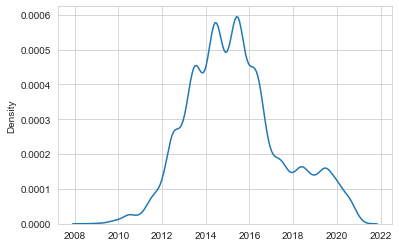

In [24]:
df['host_since'] = pd.to_datetime(df.host_since)
sns.set_style('whitegrid')
sns.kdeplot(np.array(df.host_since))

#### Count of host's listings - density

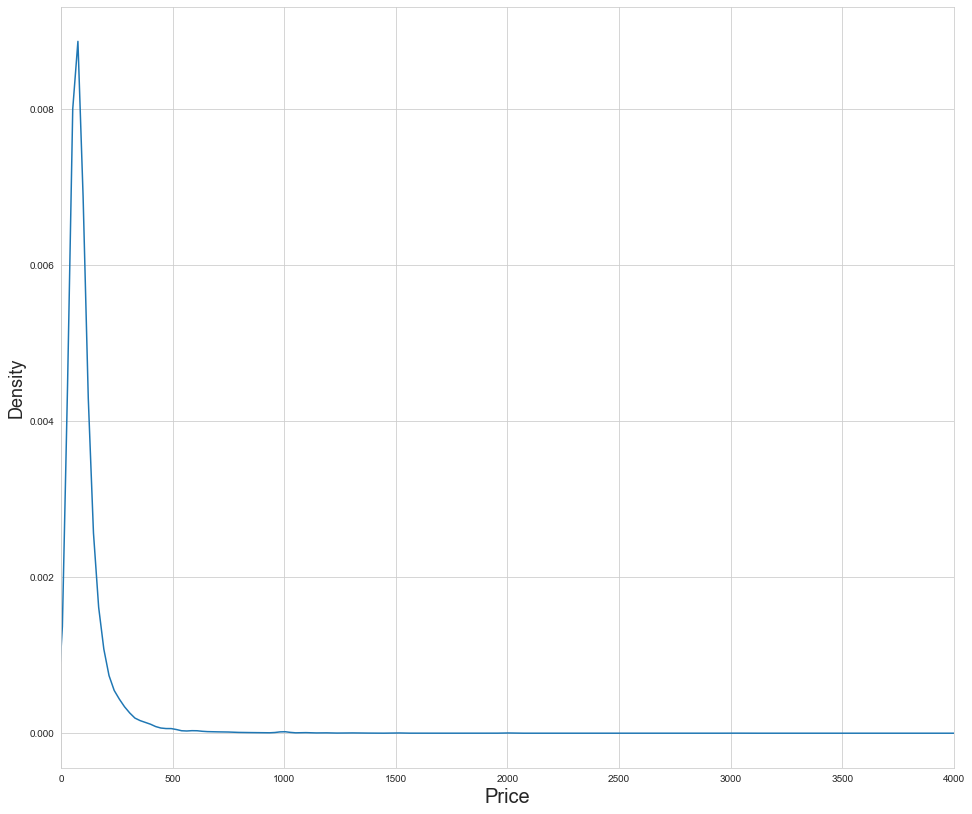

In [25]:
fig = plt.figure(figsize=(16,14))
df['price'].plot(kind='kde')
plt.xlim(0,4000)
plt.xlabel('Price', fontsize = 20)
plt.ylabel('Density', fontsize = 18)
plt.savefig('priceDist.png', dpi=1500)

#### Wordcloud graph with most used words in the "name" column

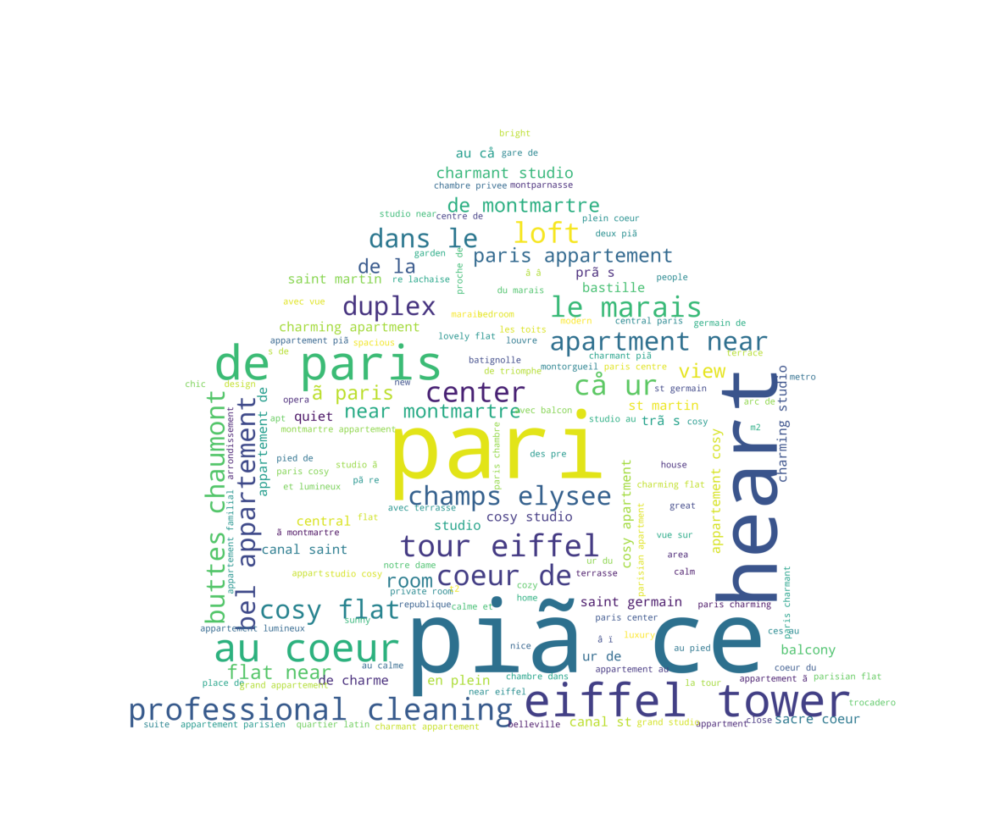

In [26]:
house = np.array(Image.open('Airbnb_Data/domek.jpg'))
df['name'] = df.name.apply(str)
names = ' '.join(df['name'].str.lower().values)
wordcloud = WordCloud(background_color='white',
                        height=900,
                        width=800,
                        scale=20,
                        prefer_horizontal=0.9999,
                        mask=house
                     ).generate(names)
plt.figure(figsize=[25, 18])
plt.imshow(wordcloud)
plt.axis('off')
#plt.savefig('WordName.jpg', dpi=900, bbox_inches='tight', quality=95)
plt.show()

#### Number of listings in neighbourhoods, top 15

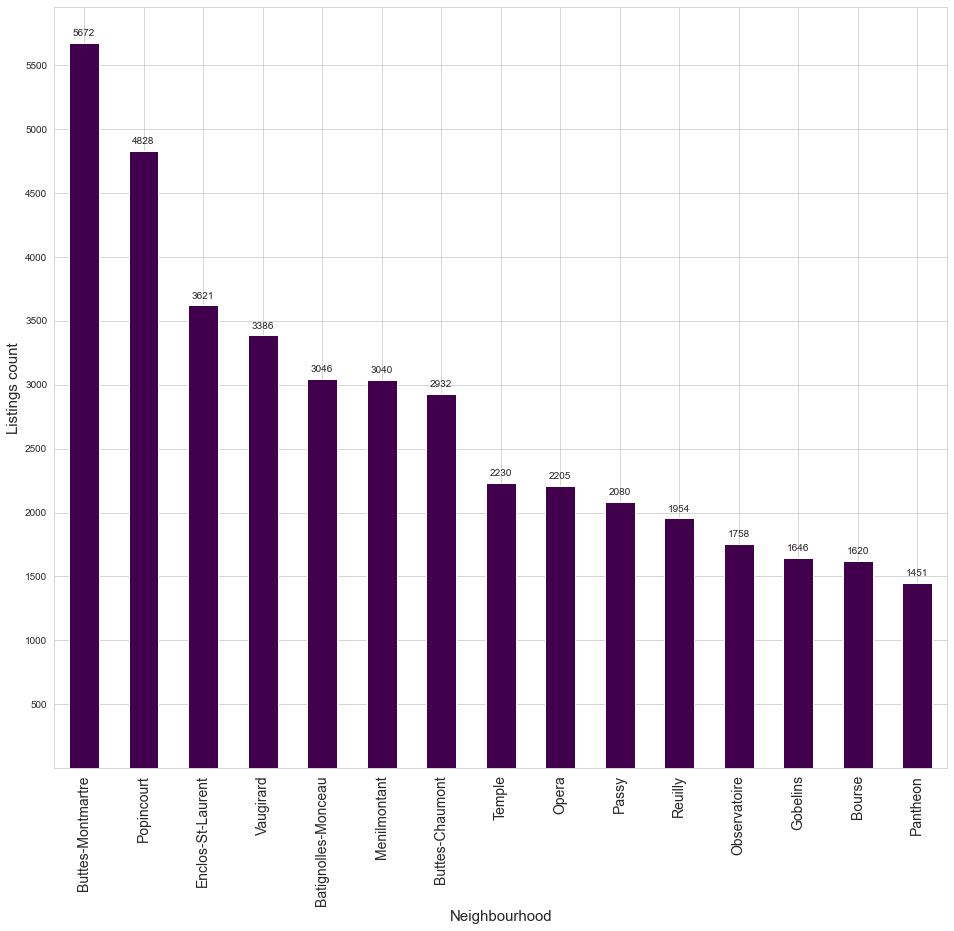

In [27]:
fig = plt.figure(figsize=(16,14))

ax = df.groupby('neighbourhood').nunique()['listing_id'].sort_values(ascending=False)[:15].plot(kind='bar',colormap='PRGn')
def barValuesVert(ax, spacing=5):

    for rect in ax.patches:
        y_value = rect.get_height()
        x_value = rect.get_x() + rect.get_width() / 2
        space = spacing
        va = 'bottom'


        label = "{:d}".format(y_value)
        ax.annotate(
            label,
            (x_value, y_value),
            xytext=(0, space),
            textcoords="offset points",
            ha='center',
            va=va)

barValuesVert(ax)
plt.ylabel('Listings count',fontsize=15)
plt.xlabel('Neighbourhood',fontsize=15)
plt.xticks(fontsize = 14)
plt.grid
plt.yticks(np.arange(500,5501,500))


plt.show()

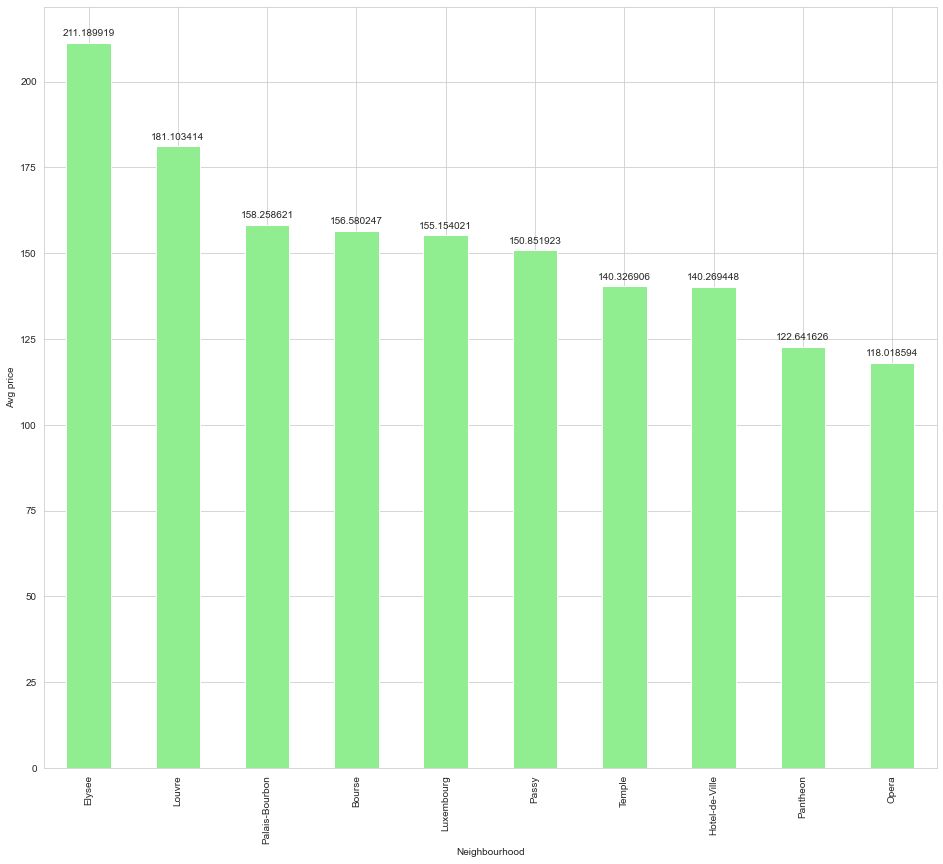

In [40]:
#average price in neighbourhoods
fig = plt.figure(figsize=(16,14))

ax = df.groupby('neighbourhood').mean()['price'].sort_values(ascending=False)[:10].plot(kind='bar',color = 'lightgreen')
def barValuesVert(ax, spacing=5):

    for rect in ax.patches:
        y_value = rect.get_height()
        x_value = rect.get_x() + rect.get_width() / 2
        space = spacing
        va = 'bottom'


        label = "{:f}".format(y_value)
        ax.annotate(
            label,
            (x_value, y_value),
            xytext=(0, space),
            textcoords="offset points",
            ha='center',
            va=va)

plt.ylabel('Avg price')
plt.xlabel('Neighbourhood')
barValuesVert(ax)
#plt.yticks([1000,2000,3000,4000,5000,6000,7000])
plt.savefig('PriceCityParts.png', dpi=1500)
plt.show()

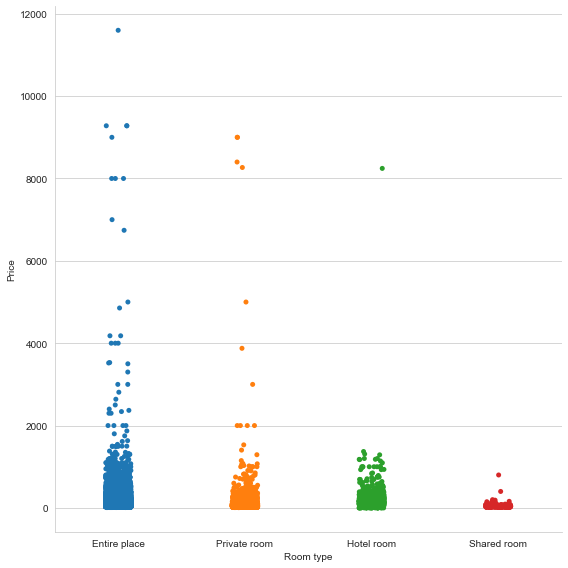

In [31]:
#price according to room types
g = sns.catplot(x='room_type', y='price', data=df, height=8)
g.set_axis_labels('Room type', 'Price')


#### Map with listings - one with price separated values and one heatmap

In [32]:
from folium.plugins import HeatMap
mapPoint = folium.Map([48.86,2.38],zoom_start=12)
for index, row in df.iterrows():
    if df.price_category[index] == 'Cheap':
        folium.CircleMarker( location=[df.latitude[index], df.longitude[index]],color='blue', radius=1 ).add_to( mapPoint )
    elif df.price_category[index] == 'Average':
        folium.CircleMarker( location=[df.latitude[index], df.longitude[index]],color='orange', radius=1 ).add_to( mapPoint )
    elif df.price_category[index] == 'Expansive':
        folium.CircleMarker( location=[df.latitude[index], df.longitude[index]],color='red', radius=1 ).add_to( mapPoint )



#mapPoint.save( 'PointMap.html')
display(mapPoint)

In [41]:
df['room_type'].value_counts()

Entire place    40771
Private room     5559
Hotel room        853
Shared room       285
Name: room_type, dtype: int64

In [44]:
mapPoint = folium.Map([48.86,2.38],zoom_start=12)
for index, row in df.iterrows():
    if df.room_type[index] == 'Entire place':
        #folium.CircleMarker( location=[df.latitude[index], df.longitude[index]],color='blue', radius=1 ).add_to( mapPoint )
        continue
    elif df.room_type[index] == 'Private room':
        folium.CircleMarker( location=[df.latitude[index], df.longitude[index]],color='orange', radius=1 ).add_to( mapPoint )
    elif df.room_type[index] == 'Hotel room':
        folium.CircleMarker( location=[df.latitude[index], df.longitude[index]],color='red', radius=1 ).add_to( mapPoint )
    elif df.room_type[index] == 'Shared room':
        folium.CircleMarker( location=[df.latitude[index], df.longitude[index]],color='blue', radius=1 ).add_to( mapPoint )



#mapPoint.save( 'PointMap.html')
display(mapPoint)

In [33]:
mapHeat = folium.Map([48.86,2.38],zoom_start=12)
HeatMap(df[['latitude','longitude']].dropna(),radius=8,gradient={0.2:'blue',0.4:'purple',0.6:'orange',1.0:'red'}).add_to(mapHeat)

#mapHeat.save( 'HeatMap.html')
display(mapHeat)

#### Histograms of numerical features

<ipython-input-34-945c0f86f323>:3: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  df.hist(ax=ax)


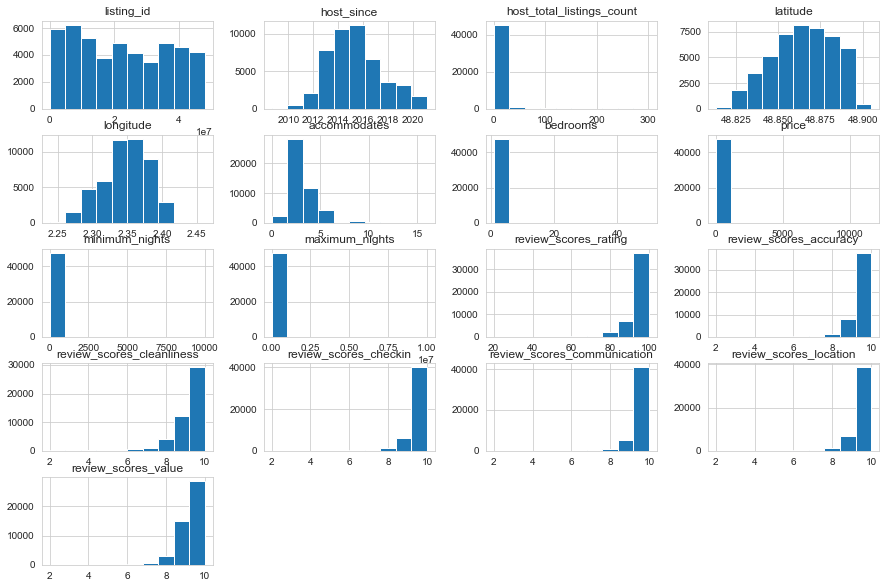

In [34]:
fig = plt.figure(figsize = (15,10))
ax = fig.gca()
df.hist(ax=ax)
plt.show()